<a href="https://colab.research.google.com/github/Nabajyoti4/leaf-disease-detection-with-CNN/blob/main/Plant_disease_model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Import required Libraries

In [ ]:
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential

import tensorflow as tf
import sklearn.metrics

from datetime import datetime
import io
import itertools
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np

### Import the directories

In [ ]:
import os
%load_ext tensorboard

base_dir = 'drive/My Drive/plant_disease'

train_dir = os.path.join(base_dir, 'train')
validation_dir = os.path.join(base_dir, 'validation')
test_dir = os.path.join(base_dir, 'test')

In [ ]:
# select the images from directory
train_ds = tf.keras.preprocessing.image_dataset_from_directory(
  train_dir,
  label_mode='int',
  seed=123,
  shuffle=True,
  image_size=(224,224),
  batch_size=123)

Found 15202 files belonging to 8 classes.


In [ ]:
class_names = train_ds.class_names
print(class_names)

['Apple___Apple_scab', 'Apple___healthy', 'Corn_(maize)___Northern_Leaf_Blight', 'Corn_(maize)___healthy', 'Potato___Early_blight', 'Potato___healthy', 'Tomato___Bacterial_spot', 'Tomato___healthy']


In [ ]:
# dataset for validation
valid_ds = tf.keras.preprocessing.image_dataset_from_directory(
  validation_dir,
  label_mode='int',
  seed=123,
  shuffle=False,
  image_size=(224,224),
  batch_size=123)

Found 3795 files belonging to 8 classes.


In [ ]:
test_ds = tf.keras.preprocessing.image_dataset_from_directory(
  test_dir,
  label_mode='int',
  seed=123,
  shuffle=False,
  image_size=(224,224),
  batch_size=10)

Found 216 files belonging to 8 classes.


### Data Visualization

In [ ]:
# Clear out prior logging data.
!rm -rf logs/plots



logdir = "logs/plots/" + datetime.now().strftime("%Y%m%d-%H%M%S")
file_writer = tf.summary.create_file_writer(logdir)

def plot_to_image(figure):
  """Converts the matplotlib plot specified by 'figure' to a PNG image and
  returns it. The supplied figure is closed and inaccessible after this call."""
  # Save the plot to a PNG in memory.
  buf = io.BytesIO()
  plt.savefig(buf, format='png')
  # Closing the figure prevents it from being displayed directly inside
  # the notebook.
  plt.close(figure)
  buf.seek(0)
  # Convert PNG buffer to TF image
  image = tf.image.decode_png(buf.getvalue(), channels=4)
  # Add the batch dimension
  image = tf.expand_dims(image, 0)
  return image

# to plot training images
def train_image_grid():
  """Return a 5x5 grid of the MNIST images as a matplotlib figure."""
  figure = plt.figure(figsize=(10, 10))
  for images, labels in train_ds.take(1):
    for i in range(10):
      plt.subplot(5, 5, i + 1, title=class_names[labels[i]])
      plt.xticks([])
      plt.yticks([])
      plt.grid(False)
      plt.imshow(images[i].numpy().astype("uint8"))
  return figure

# to plot validation images
def valid_image_grid():
  """Return a 5x5 grid of the MNIST images as a matplotlib figure."""
  figure = plt.figure(figsize=(10, 10))
  for images, labels in valid_ds.take(1):
    for i in range(10):
      plt.subplot(5, 5, i + 1, title=class_names[labels[i]])
      plt.xticks([])
      plt.yticks([])
      plt.grid(False)
      plt.imshow(images[i].numpy().astype("uint8"))
  return figure  

# Prepare the plot
train_figure = train_image_grid()
valid_figure = valid_image_grid()

# Convert to image and log
with file_writer.as_default():
  tf.summary.image("Training data", plot_to_image(train_figure), step=0)
  tf.summary.image("Validation data", plot_to_image(valid_figure), step=1)

%tensorboard --logdir logs/plots

Reusing TensorBoard on port 6006 (pid 2241), started 0:01:18 ago. (Use '!kill 2241' to kill it.)

<IPython.core.display.Javascript object>

#### Traning dataset

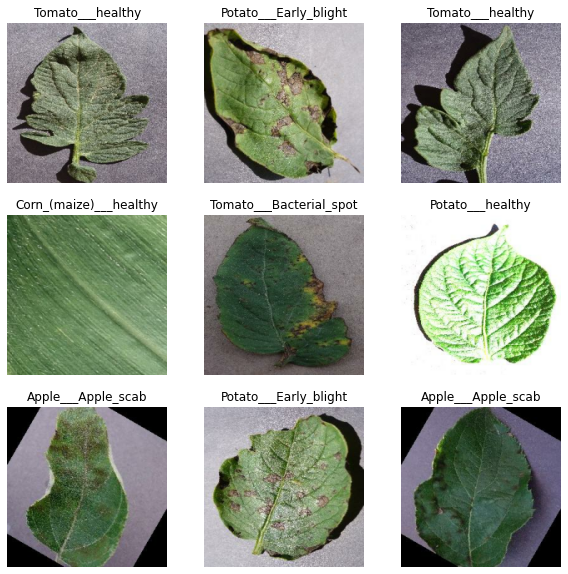

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 10))
for images, labels in train_ds.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")

#### Validation Dataset

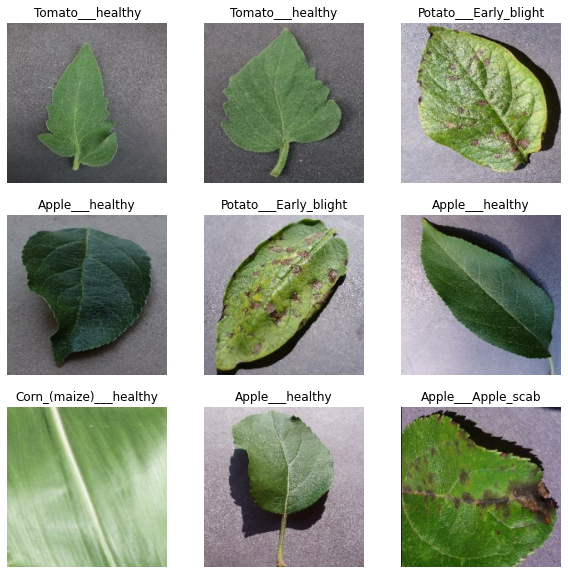

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 10))
for images, labels in valid_ds.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")

In [ ]:
# batch shape 
for image_batch, labels_batch in train_ds:
  print(image_batch.shape)
  print(labels_batch.shape)
  break

(123, 224, 224, 3)
(123,)


In [ ]:
len(train_ds) # training images / batch size => 15202 / 123 = 124 approx 

124

In [ ]:
# batch shape 
for image_batch, labels_batch in train_ds:
  print(labels_batch)
  break

tf.Tensor(
[6 5 1 6 6 2 3 2 3 1 1 4 4 3 2 5 2 1 7 6 3 0 4 3 0 6 6 6 5 7 4 7 3 1 6 7 7
 3 3 0 0 2 3 1 6 6 4 2 4 0 4 7 3 1 0 6 5 0 7 1 0 2 5 4 2 4 7 2 1 2 4 4 7 2
 0 3 2 1 2 7 2 7 1 5 7 3 5 6 5 0 6 2 4 1 7 7 4 1 4 1 4 2 7 1 2 4 4 7 1 6 7
 5 1 0 0 3 7 2 5 1 6 4 7], shape=(123,), dtype=int32)


In [ ]:
def unbatch_dataset(batch_dataset):

  """
  Take a valid  batch datat set and unbatch it
  """
  images = []
  labels = []


  # loop through the unbarched data
  for image , label in batch_dataset.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(label)

  return images,labels


val_images, val_labels = unbatch_dataset(valid_ds)
val_images[0], val_labels[0]

(array([[[ 10.071431 ,   6.714288 ,  26.07143  ],
         [101.80102  ,  93.58673  , 118.22959  ],
         [101.40306  ,  92.40306  , 119.40306  ],
         ...,
         [167.2857   , 166.2857   , 197.2857   ],
         [167.7143   , 166.7143   , 197.7143   ],
         [168.85716  , 167.85716  , 198.85716  ]],
 
        [[ 10.071431 ,   6.714288 ,  26.07143  ],
         [102.04592  ,  93.831635 , 118.474495 ],
         [102.21429  ,  93.21429  , 120.21429  ],
         ...,
         [166.14285  , 165.14285  , 196.14285  ],
         [166.40306  , 165.40306  , 196.40306  ],
         [167.50002  , 166.50002  , 197.50002  ]],
 
        [[ 10.096941 ,   6.7397985,  26.096941 ],
         [102.494896 ,  94.28061  , 118.92347  ],
         [103.12755  ,  94.12755  , 121.12755  ],
         ...,
         [164.99998  , 163.99998  , 194.99998  ],
         [164.64285  , 163.64285  , 194.64285  ],
         [165.57144  , 164.57144  , 195.57144  ]],
 
        ...,
 
        [[ 15.642872 ,   7.6173506

In [ ]:
len(val_labels)

3795

In [ ]:
np.array(val_labels).shape

(3795,)

In [ ]:
class_names[np.argmax(val_labels[0])]

'Apple___Apple_scab'

## Data Augumentation

In [ ]:
# image augumentation layers

data_augmentation = keras.Sequential(
  [
    layers.experimental.preprocessing.RandomFlip("horizontal", 
                                                 input_shape=(224, 
                                                              224,
                                                              3)),
    layers.experimental.preprocessing.RandomRotation(0.1),
    layers.experimental.preprocessing.RandomZoom(0.1),
  ]
)

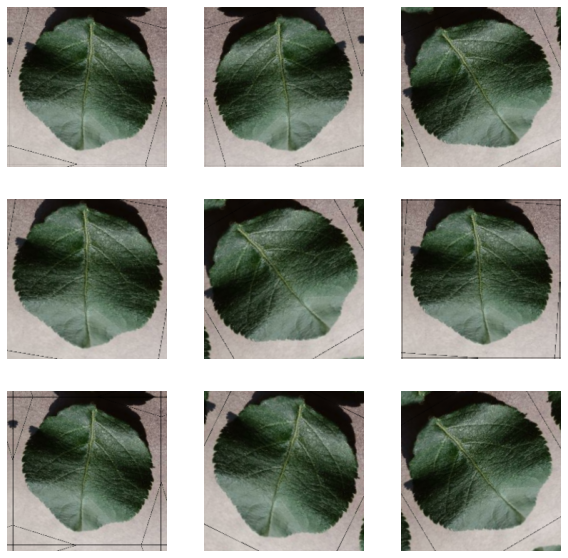

In [ ]:
# plot augemtation data
plt.figure(figsize=(10, 10))
for images, _ in valid_ds.take(1):
  for i in range(9):
    augmented_images = data_augmentation(images)
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(augmented_images[0].numpy().astype("uint8"))
    plt.axis("off")

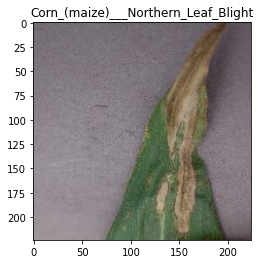

In [ ]:
image, label = next(iter(valid_ds))
_ = plt.imshow(image[i].numpy().astype("uint8"))
_ = plt.title(class_names[label[i]])

In [ ]:
def visualize(original, augmented):
  fig = plt.figure()
  plt.subplot(1,2,1)
  plt.title('Original image')
  plt.imshow(original.numpy().astype("uint8"))

  plt.subplot(1,2,2)
  plt.title('Augmented image')
  plt.imshow(augmented.numpy().astype("uint8"))

### Grayscale the image

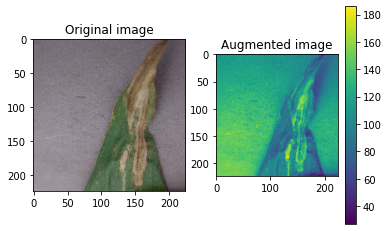

In [ ]:
grayscaled = tf.image.rgb_to_grayscale(image[i])
visualize(image[i], tf.squeeze(grayscaled))
_ = plt.colorbar()

### Saturate the image

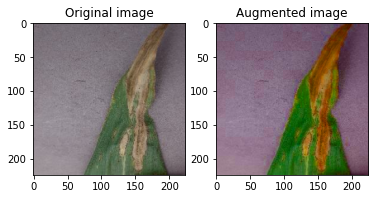

In [ ]:
saturated = tf.image.adjust_saturation(image[i], 3)
visualize(image[i], saturated)

### Bright the image

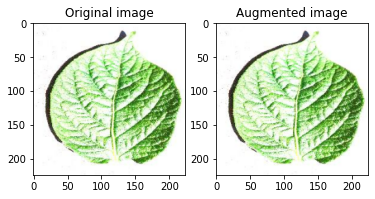

In [ ]:
bright = tf.image.adjust_brightness(image[i], 0.6)
visualize(image[i], bright)

### Crop the image

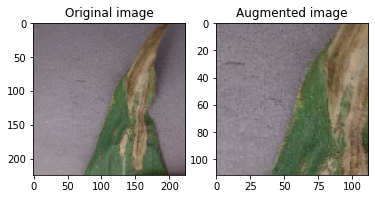

In [ ]:
cropped = tf.image.central_crop(image[i], central_fraction=0.5)
visualize(image[i],cropped)

### Rotate the image

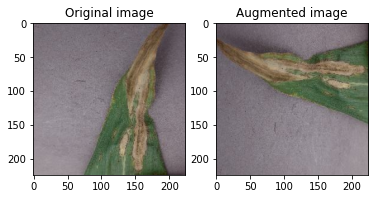

In [ ]:
rotated = tf.image.rot90(image[i])
visualize(image[i], rotated)

## Create The model

#### Cache the Dataset

In [ ]:
AUTOTUNE = tf.data.experimental.AUTOTUNE

train_ds = train_ds.cache().shuffle(1000).prefetch(buffer_size=AUTOTUNE)
valid_ds = valid_ds.cache().prefetch(buffer_size=AUTOTUNE)

#### Create the layers

In [ ]:
# create the model
model = Sequential([
                    # augmentation layer
                      data_augmentation,
                    
                    # normalization layer
                      layers.experimental.preprocessing.Rescaling(1./255),
                    
                    #convlutional layers
                      layers.Conv2D(16, 3, padding='same', activation='relu'),
                      layers.MaxPooling2D(),
                      layers.Conv2D(32, 3, padding='same', activation='relu'),
                      layers.MaxPooling2D(),
                      layers.Conv2D(64, 3, padding='same', activation='relu'),
                      layers.MaxPooling2D(),
                      layers.Dropout(0.2),
                      layers.Flatten(),
                    
                    #dense layer
                      layers.Dense(128, activation='relu'),
                      layers.Dense(64, activation='relu'),
                      layers.Dense(8, activation="softmax")
])

In [ ]:
model.summary()

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
sequential (Sequential)      (None, 224, 224, 3)       0         
_________________________________________________________________
rescaling_4 (Rescaling)      (None, 224, 224, 3)       0         
_________________________________________________________________
conv2d_13 (Conv2D)           (None, 224, 224, 16)      448       
_________________________________________________________________
max_pooling2d_13 (MaxPooling (None, 112, 112, 16)      0         
_________________________________________________________________
conv2d_14 (Conv2D)           (None, 112, 112, 32)      4640      
_________________________________________________________________
max_pooling2d_14 (MaxPooling (None, 56, 56, 32)        0         
_________________________________________________________________
conv2d_15 (Conv2D)           (None, 56, 56, 64)       

#### Compile the model

In [ ]:
model.compile(
    optimizer='adam', 
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

#### Model architecture

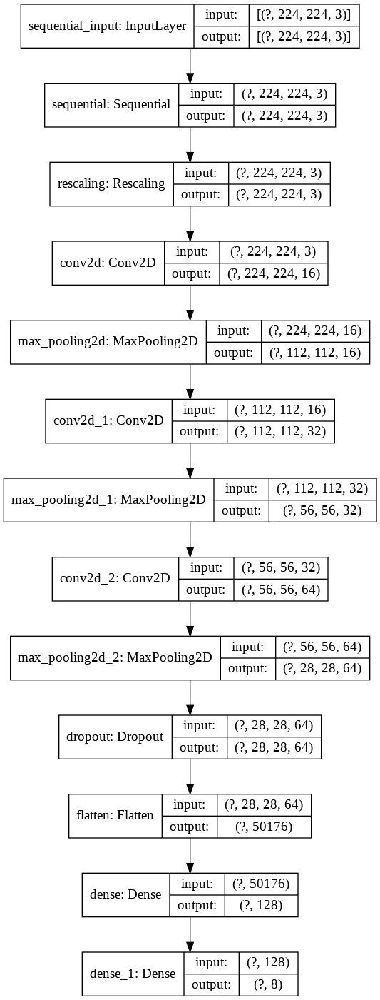

In [ ]:
tf.keras.utils.plot_model(model, show_shapes=True)

## Callbacks

### Confusion Matrix plotting

In [ ]:
def plot_to_image(figure):
  """Converts the matplotlib plot specified by 'figure' to a PNG image and
  returns it. The supplied figure is closed and inaccessible after this call."""
  # Save the plot to a PNG in memory.
  buf = io.BytesIO()
  plt.savefig(buf, format='png')
  # Closing the figure prevents it from being displayed directly inside
  # the notebook.
  plt.close(figure)
  buf.seek(0)
  # Convert PNG buffer to TF image
  image = tf.image.decode_png(buf.getvalue(), channels=4)
  # Add the batch dimension
  image = tf.expand_dims(image, 0)
  return image

In [ ]:
def plot_confusion_matrix(cm, class_names):
  """
  Returns a matplotlib figure containing the plotted confusion matrix.

  Args:
    cm (array, shape = [n, n]): a confusion matrix of integer classes
    class_names (array, shape = [n]): String names of the integer classes
  """
  figure = plt.figure(figsize=(8, 8))
  plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
  plt.title("Confusion matrix")
  plt.colorbar()
  tick_marks = np.arange(len(class_names))
  plt.xticks(tick_marks, class_names, rotation=45)
  plt.yticks(tick_marks, class_names)

  # Normalize the confusion matrix.
  cm = np.around(cm.astype('float') / cm.sum(axis=1)[:, np.newaxis], decimals=2)

  # Use white text if squares are dark; otherwise black.
  threshold = cm.max() / 2.
  for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
    color = "white" if cm[i, j] > threshold else "black"
    plt.text(j, i, cm[i, j], horizontalalignment="center", color=color)

  plt.tight_layout()
  plt.ylabel('True label')
  plt.xlabel('Predicted label')
  return figure

In [ ]:
# Clear out prior logging data.
!rm -rf logs/image

logdir =  "logs/image/" + datetime.now().strftime("%Y%m%d-%H%M%S")
# Define the basic TensorBoard callback.
tensorboard_callback = keras.callbacks.TensorBoard(log_dir=logdir)
file_writer_cm = tf.summary.create_file_writer(logdir + '/cm')

In [ ]:

def log_confusion_matrix(epoch, logs):
  # Use the model to predict the values from the validation dataset.
  test_pred_raw = model.predict(valid_ds)
  test_pred = np.argmax(test_pred_raw, axis=1)

  # Calculate the confusion matrix.
  cm = sklearn.metrics.confusion_matrix(val_labels, test_pred)
  # Log the confusion matrix as an image summary.
  figure = plot_confusion_matrix(cm, class_names=class_names)
  cm_image = plot_to_image(figure)

  # Log the confusion matrix as an image summary.
  with file_writer_cm.as_default():
    tf.summary.image("Confusion Matrix", cm_image, step=epoch)

# Define the per-epoch callback.
cm_callback = keras.callbacks.LambdaCallback(on_epoch_end=log_confusion_matrix)

### Save model weights and also Early stopping

In [ ]:
# Model weights are saved at the end of every epoch, if it's the best seen
# so far.
from tensorflow.python.keras.callbacks import EarlyStopping, ModelCheckpoint

early_stopper = EarlyStopping(monitor = 'val_loss', patience = 3)

checkpoint_filepath = base_dir + '/checkpoint'
model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath,
    save_weights_only=True,
    monitor='val_accuracy',
    mode='max',
    save_best_only=True)

## Model training

In [ ]:
%tensorboard --logdir logs/image

epochs = 10
history = model.fit(
  train_ds,
  validation_data=valid_ds,
  epochs=epochs,
  callbacks=[model_checkpoint_callback,
             early_stopper,
             tensorboard_callback, 
             cm_callback]
)

<IPython.core.display.Javascript object>

Epoch 1/10
124/124 [==============================] - 67s 537ms/step - loss: 0.8566 - accuracy: 0.6880 - val_loss: 0.2650 - val_accuracy: 0.9099
Epoch 2/10
124/124 [==============================] - 66s 533ms/step - loss: 0.2557 - accuracy: 0.9169 - val_loss: 0.2262 - val_accuracy: 0.9278
Epoch 3/10
124/124 [==============================] - 65s 526ms/step - loss: 0.1617 - accuracy: 0.9459 - val_loss: 0.2427 - val_accuracy: 0.9252
Epoch 4/10
124/124 [==============================] - 64s 519ms/step - loss: 0.1089 - accuracy: 0.9638 - val_loss: 0.1998 - val_accuracy: 0.9325
Epoch 5/10
124/124 [==============================] - 64s 517ms/step - loss: 0.0904 - accuracy: 0.9707 - val_loss: 0.0944 - val_accuracy: 0.9702
Epoch 6/10
124/124 [==============================] - 64s 513ms/step - loss: 0.0757 - accuracy: 0.9741 - val_loss: 0.1721 - val_accuracy: 0.9478
Epoch 7/10
124/124 [==============================] - 64s 520ms/step - loss: 0.0682 - accuracy: 0.9774 - val_loss: 0.3717 - val_ac

In [ ]:
model.evaluate(test_ds)

22/22 [==============================] - 0s 21ms/step - loss: 0.1513 - accuracy: 0.9537


[0.15134002268314362, 0.9537037014961243]

In [ ]:
tf.saved_model.save(model, base_dir + '/saved_model/')

INFO:tensorflow:Assets written to: drive/My Drive/plant_disease/saved_model/assets


In [ ]:
model.load_weights(base_dir + '/weights/checkpoint')

## Prediction and Evaluate

In [ ]:
model.evaluate(test_ds)

22/22 [==============================] - 1s 26ms/step - loss: 0.1513 - accuracy: 0.9537


[0.1513400375843048, 0.9537037014961243]

In [ ]:
predictions = model.predict(valid_ds)

In [ ]:
def plot_image(i, predictions_array, true_label, img):
  true_label, img = true_label[i], img
  plt.grid(False)
  plt.xticks([])
  plt.yticks([])

  plt.imshow(img)

  predicted_label = np.argmax(predictions_array)
  if predicted_label == true_label:
    color = 'blue'
  else:
    color = 'red'

  plt.xlabel("{} {:2.0f}% ({})".format(class_names[predicted_label],
                                100*np.max(predictions_array),
                                class_names[true_label]),
                                color=color)

def plot_value_array(i, predictions_array, true_label):
  true_label = true_label
  plt.grid(False)
  plt.xticks(range(8),labels=class_names,
            rotation="vertical", c="white")
  plt.yticks([])
  thisplot = plt.bar(range(8), predictions_array, color="#777777")
  plt.ylim([0, 1])
  predicted_label = np.argmax(predictions_array)

  thisplot[predicted_label].set_color('red')
  thisplot[true_label].set_color('blue')

In [ ]:
predictions[0]

array([8.5695994e-01, 4.0714559e-03, 7.8784382e-05, 2.4750905e-06,
       1.3647494e-01, 8.1387308e-04, 8.6703083e-05, 1.5118597e-03],
      dtype=float32)

In [ ]:
np.argmax(predictions[0])

0

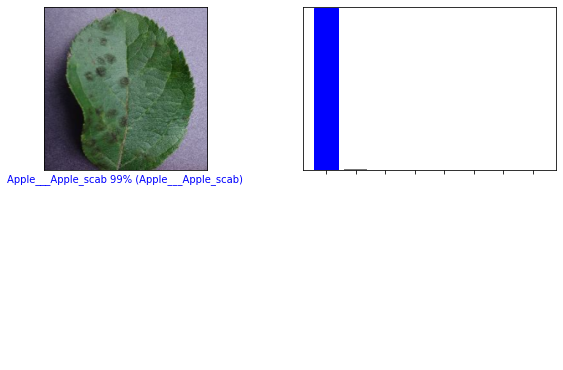

In [ ]:
i = 18
plt.figure(figsize=(10,3))
plt.subplot(1,2,1)
plot_image(i , predictions[i], val_labels, np.array(val_images[i]).astype("uint8"))
plt.subplot(1,2,2)
plot_value_array(i, predictions[i],  val_labels[i])
plt.show()

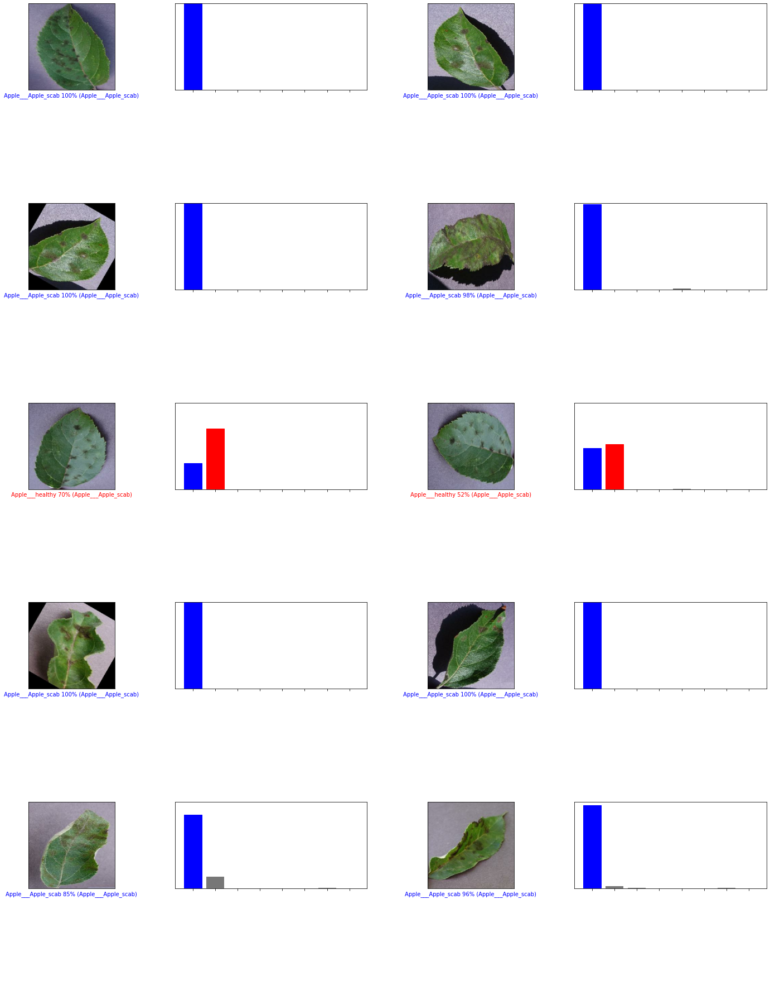

In [ ]:
i_multiplier = 400
num_rows = 5
num_cols = 2
num_images = num_rows*num_cols
plt.figure(figsize=(10*num_cols, 5*num_rows))
for i in range(num_images):
  plt.rc('font', size=10)  
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_image(i + i_multiplier, predictions[i + i_multiplier], val_labels, np.array(val_images[i + i_multiplier]).astype("uint8"))
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_value_array(i + i_multiplier, predictions[i + i_multiplier], val_labels[i + i_multiplier])
plt.tight_layout(h_pad=1.0)
plt.show()

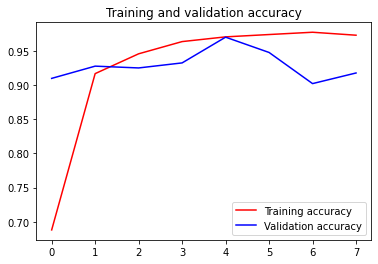

<Figure size 432x288 with 0 Axes>

In [ ]:
import matplotlib.pyplot as plt
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(len(acc))

plt.plot(epochs, acc, 'r', label='Training accuracy')
plt.plot(epochs, val_acc, 'b', label='Validation accuracy')
plt.title('Training and validation accuracy')
plt.legend(loc=0)
plt.figure()


plt.show()

## Testing

Saving 1_tomato_healthy.JPG to 1_tomato_healthy.JPG
Tomato___healthy


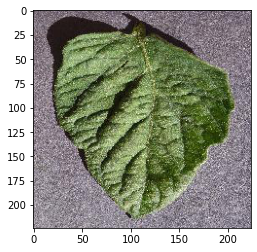

In [ ]:
import numpy as np
from google.colab import files
from keras.preprocessing import image

uploaded = files.upload()

for fn in uploaded.keys():
 
  # predicting images
  path = fn
  img = image.load_img(path, target_size=(224,224))
  x = image.img_to_array(img)
  x = np.expand_dims(x, axis=0)

  images = np.vstack([x])
  classes = model.predict(images)
  print(class_names[classes[0].argmax()])
  plt.imshow(image.img_to_array(img).astype("uint8"))